In [ ]:
import cv2

In [ ]:
imagem = cv2.imread("/ponte_golden_gat.jpg")

In [ ]:
#O seu corpo
imagem.shape

(725, 1200, 3)

In [ ]:
print('Altura: {} pixels'.format(imagem.shape[0]))
print('Largura: {} pixels'.format(imagem.shape[1]))
print('Canais: {}'.format(imagem.shape[2]))

Altura: 725 pixels
Largura: 1200 pixels
Canais: 3


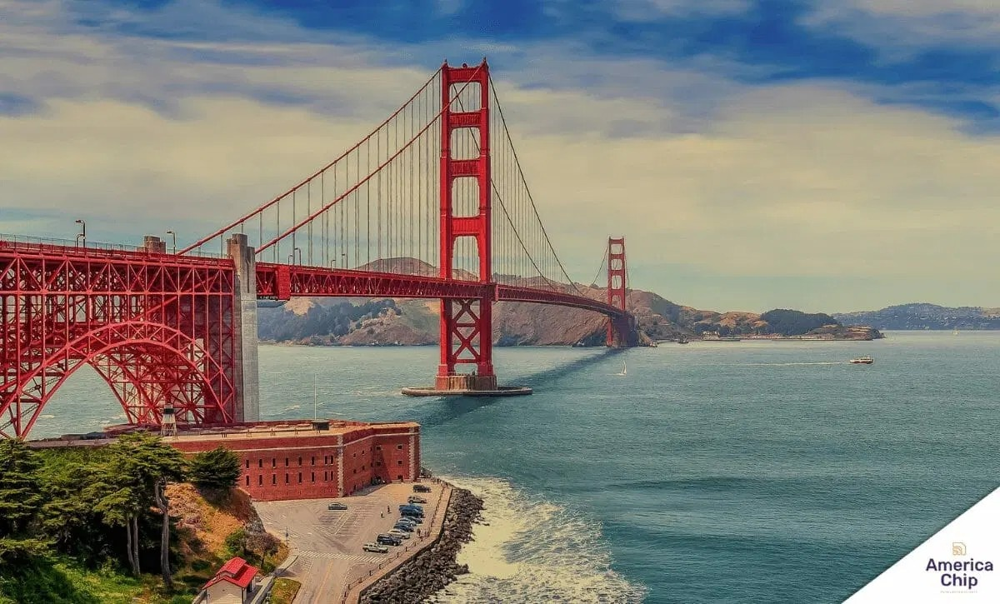

In [ ]:
#Mostrando imagem
from google.colab.patches import cv2_imshow
cv2_imshow(imagem)

In [ ]:
#Salvando imagem
cv2.imwrite('/ponte_golden_gat.jpg', imagem)

True

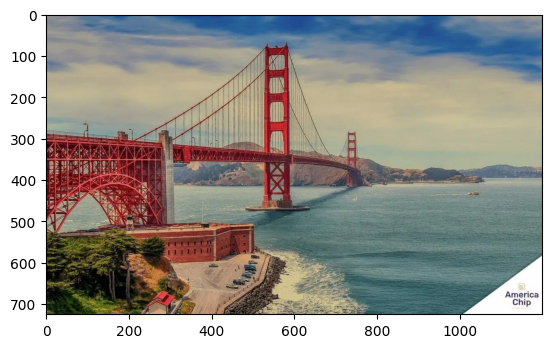

In [ ]:
#O opencv carrega a imagem de maneira diferente, ao inves do padrão RGB
#ele usa BGR e para mudar isso usa o cvtColor, que converte a imagem para RGB
from matplotlib import pyplot as plt
imagem_rgb = cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB)
plt.imshow(imagem_rgb)
plt.show()

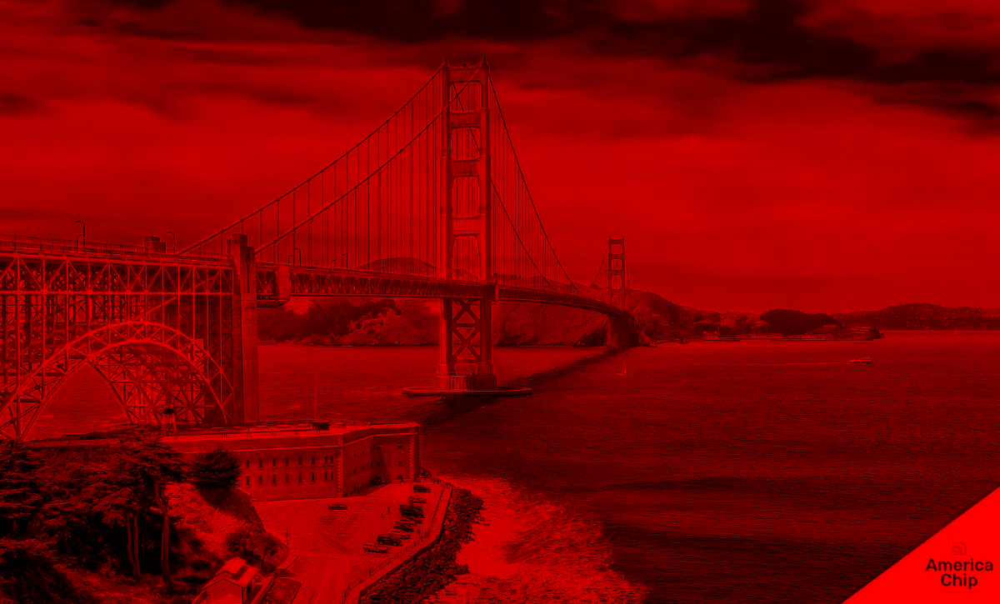

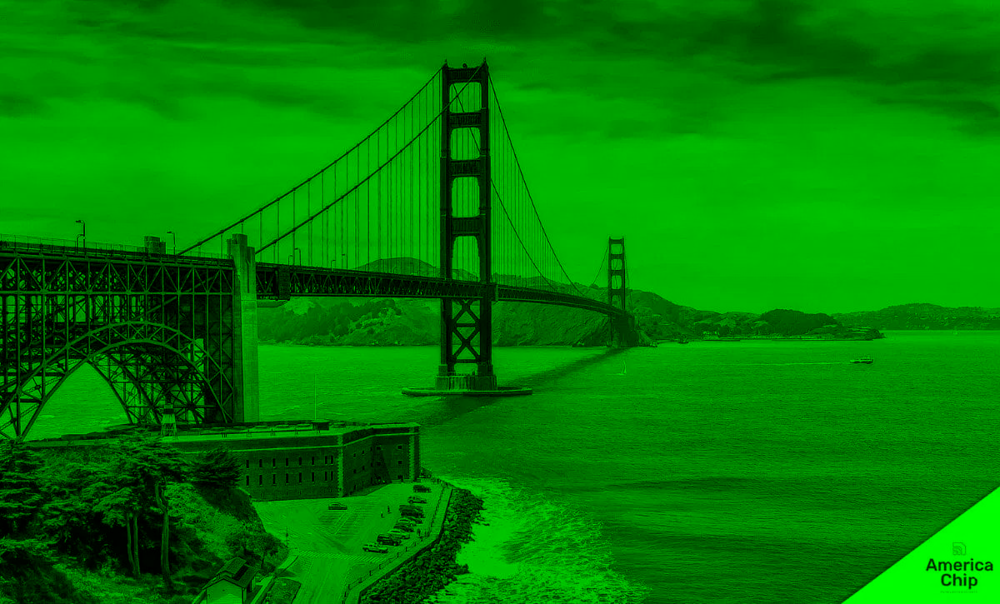

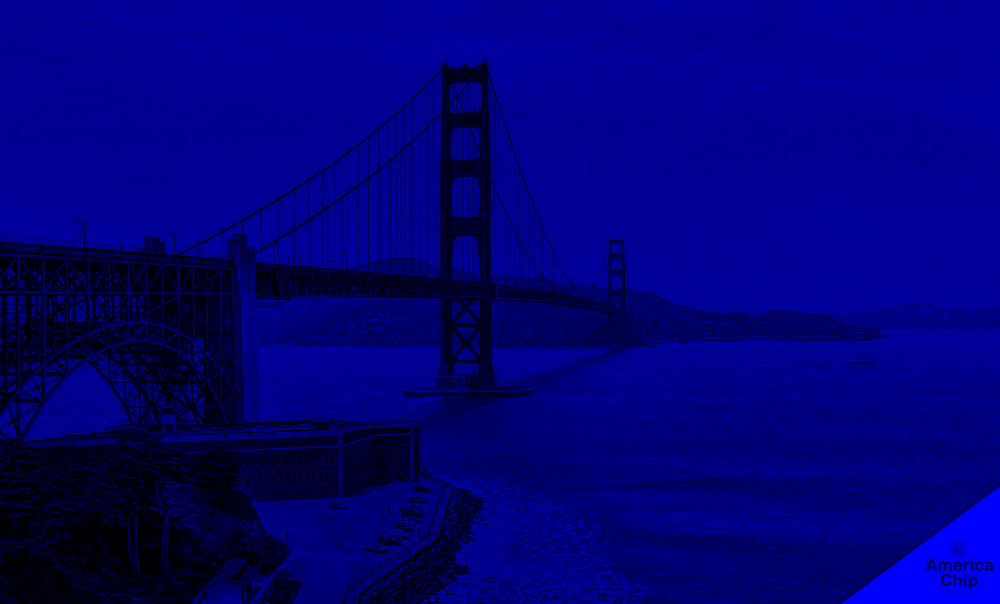

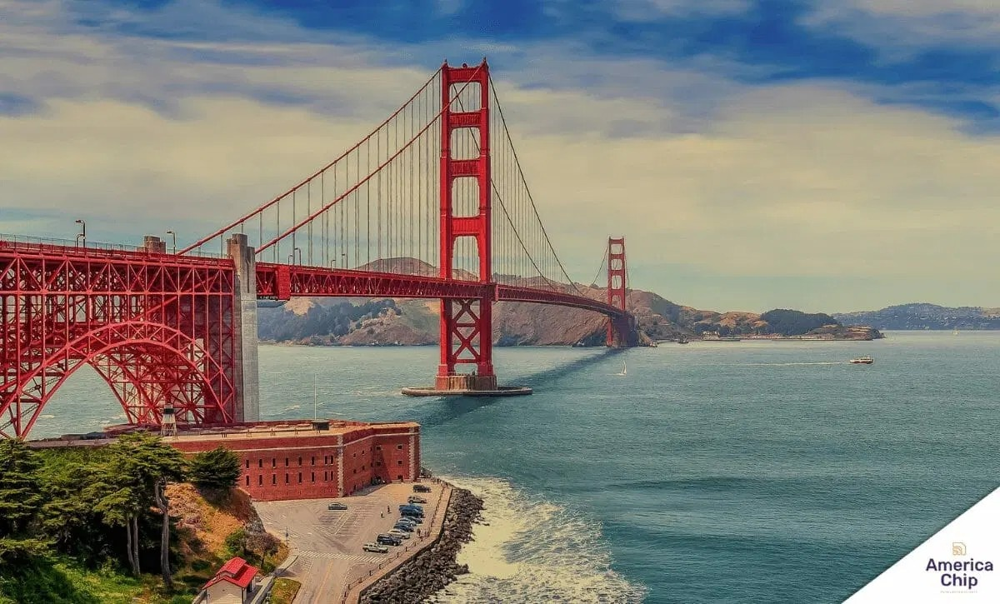

In [ ]:
#Agora separando os canais de cores usando o Splitting e Merging
#Pois são formadas 3 imagens cada um com um canal de cor e é feito uma soma
#Vou separar, com o intuiito de ver cada uma individualmente
(b, g, r) = cv2.split(imagem)
import numpy as np
zeros = np.zeros(imagem.shape[:2], dtype = "uint8") #Cria uma matriz de duas dimençoes (altura, largura) preenchido por zeros
cv2_imshow(cv2.merge([zeros, zeros, r]))
cv2_imshow(cv2.merge([zeros, g, zeros]))
cv2_imshow(cv2.merge([b, zeros, zeros]))

# Juntando novamente a imagem
from google.colab.patches import cv2_imshow
merged = cv2.merge([b, g, r])
cv2_imshow(merged)

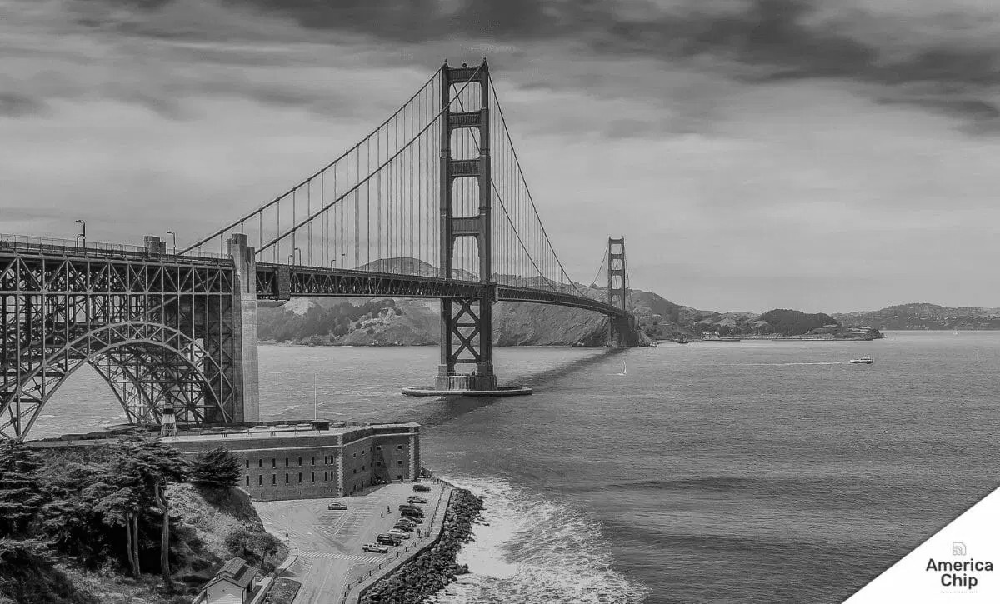

In [ ]:
#Agora convertendo o imagem para escala de cinza
imagem_cinza = cv2.cvtColor(imagem, cv2.COLOR_BGR2GRAY)
cv2_imshow(imagem_cinza)

In [ ]:
imagem_cinza.shape

(725, 1200)

In [ ]:
#Agora coletando um pixel especifico da imagem
(b, g, r) = imagem[600,1000]
print('O pixel tem os seguites valores de RGB: {}, {}, {}'.format(r, g, b))

O pixel tem os seguites valores de RGB: 54, 89, 91


In [ ]:
#Agora mudando o valor do pixel, adicionando novos valores no mesmo
imagem[600,1000] = (0, 1, 244)
(b, g, r) = imagem[600,1000]
print('O pixel tem os seguites valores de RGB: {}, {}, {}'.format(r, g, b))

O pixel tem os seguites valores de RGB: 244, 1, 0


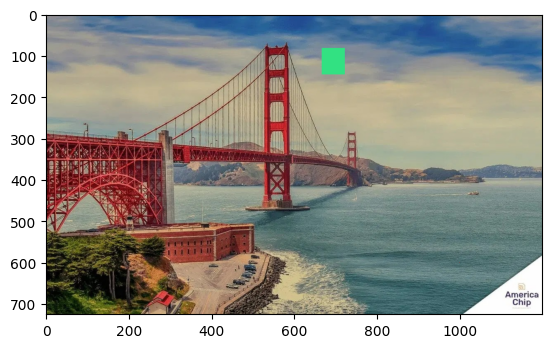

In [ ]:
#Agora manipulando varios pixels da imagem
#É preciso usar o comando .copy(), caso contrario, as alteraçoes feitas na variavel vai impactar a original
imagem_pintada = imagem.copy()
imagem_pintada[82:146, 667:723] = (130, 225, 50)
imagem_rgb = cv2.cvtColor(imagem_pintada, cv2.COLOR_BGR2RGB)
plt.imshow(imagem_rgb)
plt.show()

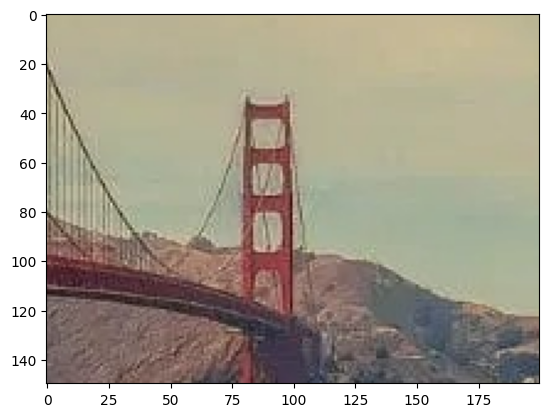

In [ ]:
#Agora recortando um pedaço da imagem
retangulo = imagem[250:400, 650:850] #Aqui selecina o espaço começa na vertical e depois horizontal
imagem_rgb = cv2.cvtColor(retangulo, cv2.COLOR_BGR2RGB)
plt.imshow(imagem_rgb)
plt.show()

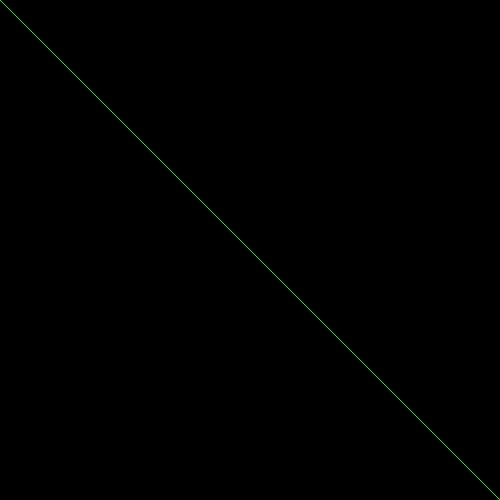

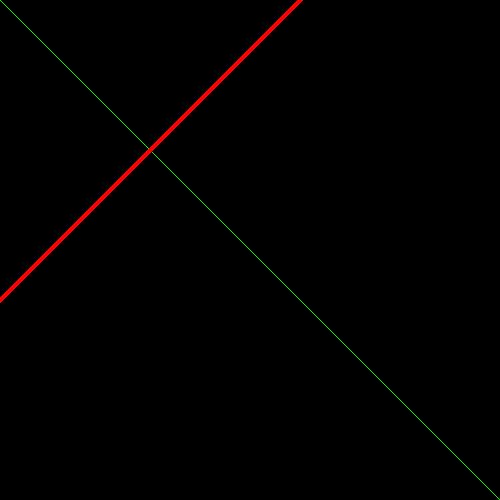

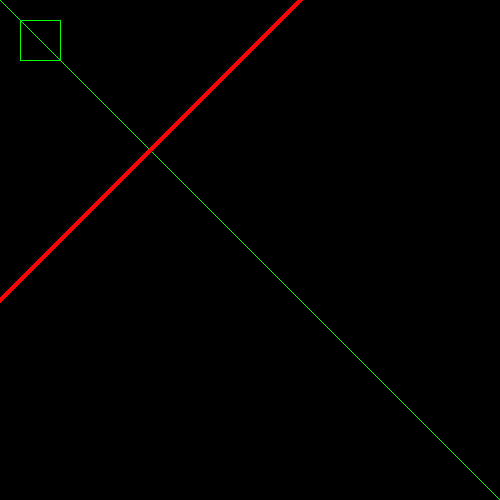

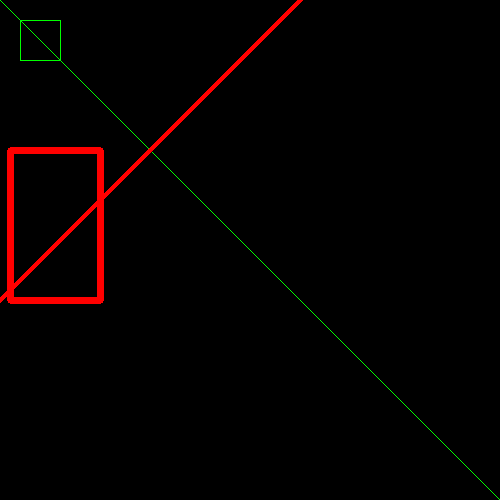

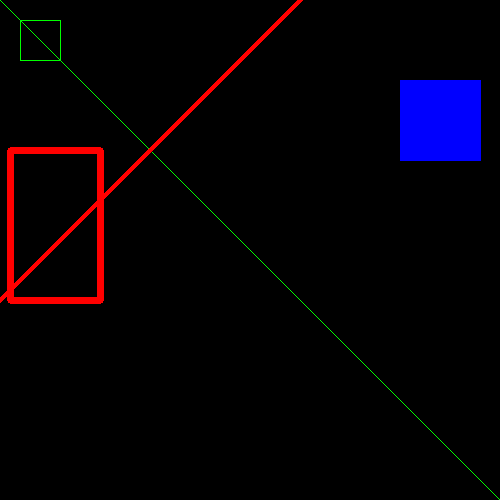

In [ ]:
#Agora vou desenhar minha propria imagem
import numpy as np

#Inicializando nessa tela com um espaço de pixels de 500x500 com 3 cores (RGB)
espaco = np.zeros((500, 500, 3), dtype = "uint8")

#Desenhando uma linha verde do canto superior esquerdo até o canto inferior direito
verde = (0, 255, 0)
cv2.line(espaco, (0, 0), (500, 500), verde)
cv2_imshow(espaco)

#Desenhando uma linha vermelha de 3 pixels de espessura do canto inferior esquerdo para a parte superior direita
vermelho = (0, 0, 255)
cv2.line(espaco, (300, 0), (0, 300), vermelho, 3)
cv2_imshow(espaco)

#Desenhando um quadrado verde de 40x40 pixels, começando com 20x20 e termina com 60x60
cv2.rectangle(espaco, (20,20), (60,60), verde)
cv2_imshow(espaco)

#Agora outro retangulo, dessa vez vermelho e com 5 pixels de espessura
cv2.rectangle(espaco, (10,150), (100,300), vermelho, 5)
cv2_imshow(espaco)

#Desenhando mais um retangulo: azul e preenchido
azul = (255, 0, 0)
cv2.rectangle(espaco, (400,80), (480,160), azul, -1)
cv2_imshow(espaco)

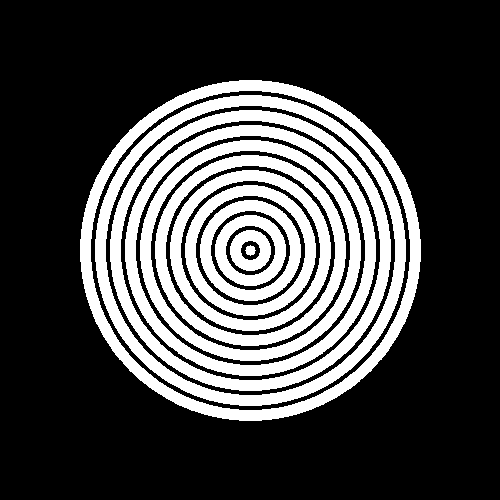

In [ ]:
#Desenhando um circulo no centro da tela com varios circulos ao redor
espaco = np.zeros((500, 500, 3), dtype = "uint8")
(centro_x, centro_y) = (espaco.shape[1]//2, espaco.shape[0]//2) # Localização x, y do centro do circulo
branco = (255, 255, 255)
for raio in range(0, 175, 15):
  cv2.circle(espaco, (centro_x, centro_y), raio, branco, 10)
cv2_imshow(espaco)

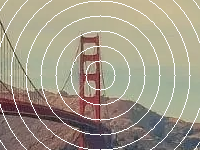

In [ ]:
#Agora desenhando por cima de uma imagem
imagem_desenho = cv2.cvtColor(imagem_rgb, cv2.COLOR_BGR2RGB)
(centro_x, centro_y) = (imagem_desenho.shape[1]//2, imagem_desenho.shape[0]//2)
branco = (255, 255, 255)
for raio in range(0, 175, 15):
  cv2.circle(imagem_desenho, (centro_x, centro_y), raio, branco)
cv2_imshow(imagem_desenho)


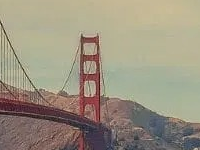

In [ ]:
#Outro exemplo de desenho por cima da imagem, criando pontinho em toda a imagem
imagem_desenho = cv2.cvtColor(imagem_rgb, cv2.COLOR_BGR2RGB)
for y in range(0, imagem_desenho.shape[0], 10):
  for x in range(0, imagem_desenho.shape[1], 10):
    imagem_rgb[y:y+3, x:x+3] = (255, 255, 255)
cv2_imshow(imagem_desenho)
plt.show()

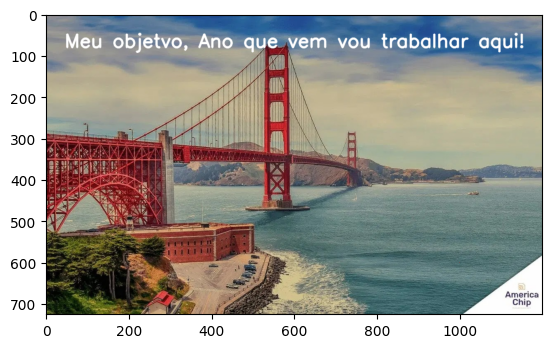

In [ ]:
#Agora é escrevendo em uma imagem usando o putText
imagem_texto = cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB)
fonte = cv2.FONT_ITALIC
linha = cv2.LINE_AA
#(imagem, texto, localização_inicial, tipo da fonte, escala_fonte, cor_BGR, espessura, tipo_linha)
cv2.putText(imagem_texto, "Meu objetvo, Ano que vem vou trabalhar aqui!", (45,80), fonte, 1.5, (255,255,255), 3, linha)
plt.imshow(imagem_texto)
plt.show()

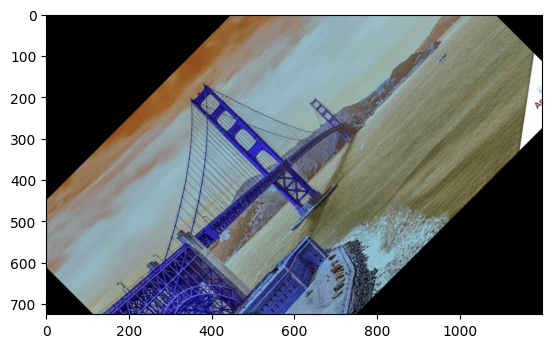

In [ ]:
#Agora para rotacionar a imagem:
#Obtendo as dimençoes da imagem e seu centro:
(altura, largura) = imagem.shape[:2]
centro = (largura//2, altura//2)

#Rotacionando a imgagem em 45 graus:
parametros_rot = cv2.getRotationMatrix2D(centro, 45,1.0) #(centro, ângulo_rotação, escala) "esala é o zoom"
rotacionado = cv2.warpAffine(imagem, parametros_rot, (largura, altura)) #(imagem, paramêtros, dimençoes_img_saida)
plt.imshow(rotacionado)
plt.show()

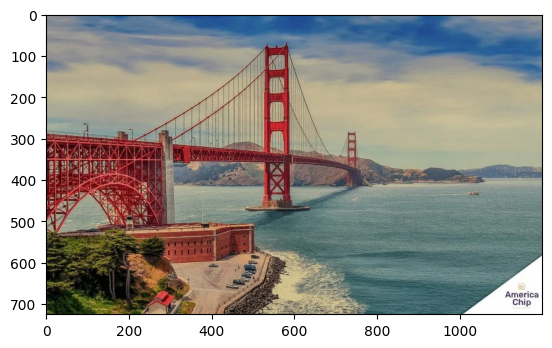

In [ ]:
from matplotlib import pyplot as plt
imagem_col = cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB)
plt.imshow(imagem_col)
plt.show()

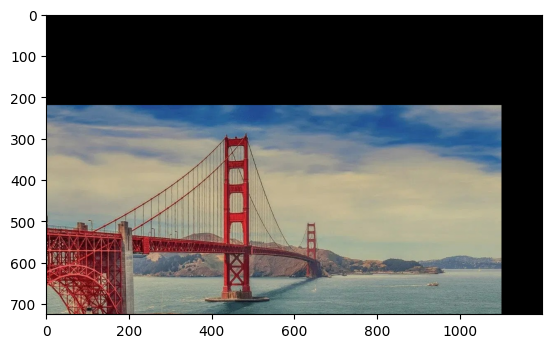

In [ ]:
#Deslocando uma imagem, usando o warpAffine:
#Dimençoes da imagem:
(altura, largura) = imagem_col.shape[:2]
#Precisa especificar quantos pixels quero mover nas direçoes x e y, dessa forma:
#[[1,0, shift_x], [0,1, shift_y]]. 1,0:Horizontal, 0,1:Vertical, positivo é para direita e negativo é esquerda "movimentação dos pixels"
import numpy as np
parametros_shift = np.float32([[1,0,-98], [0,1,220]])
deslocado = cv2.warpAffine(imagem_col, parametros_shift, (largura, altura))
plt.imshow(deslocado)
plt.show()

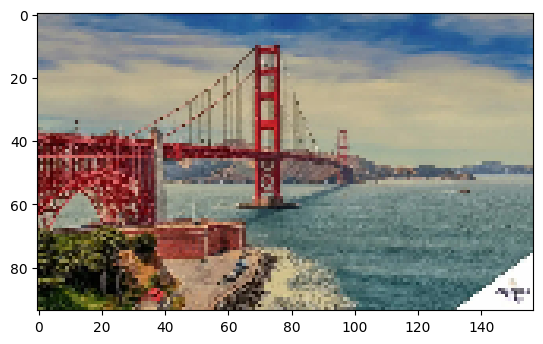

In [ ]:
#Redimencionando uma imagem usando o resize:
#Obtndo as dimesções da imagem:
(altura, largura) = imagem_col.shape[:2]
nova_largura= 157

#Definindo 157 pixels de largura, mantendo a proporção da imagem:
proporcao = altura/largura
nova_dim = (nova_largura, int(nova_largura*proporcao))

#Execultando o redimensionamento da imagem:
redimensionada = cv2.resize(imagem_col, nova_dim, interpolation= cv2.INTER_LINEAR)
plt.imshow(redimensionada)
plt.show()

#A interpolação serve para redução de dimencionalidade, abaixando a qualidade dela
#É feito usando calculos matematicos para escolher os pixels

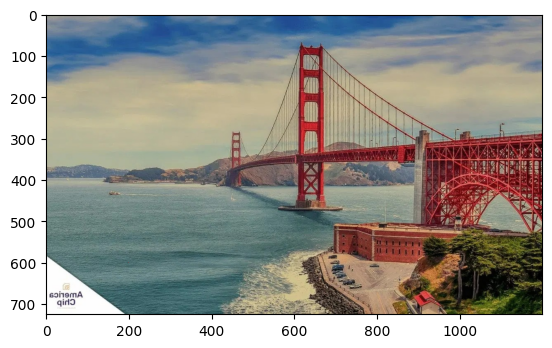

In [ ]:
#Invertendo uma imegem usando o Flipping:
# 1 é horizontal, 0 é vertical, -1 é horizontal e vertical
flipped = cv2.flip(imagem_col, 1)
plt.imshow(flipped)
plt.show()

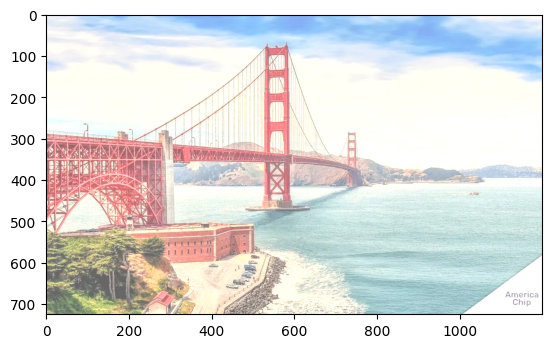

In [ ]:
#Operações aritméticas com imagens:
#As imagens são matrizes numericas e elas podem ser manipuladas matematicamente.
#Vou realçar o brilho da imagem deixando os mais fortes, e para isso vou fazer uma soma de matriz:
import numpy as np
matriz = np.ones(imagem_col.shape, dtype = "uint8")*100 #Cria uma matriz de mesma dimeção, com cada pixel igual a 100
soma = cv2.add(imagem_col, matriz)
plt.imshow(soma)
plt.show()

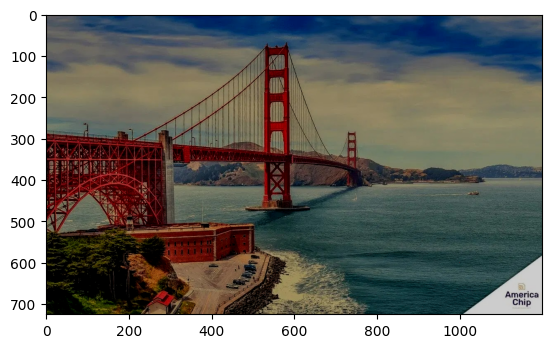

In [ ]:
#Operaçoões aritimatcas com imagens:
#Agora vou escurecer a imagem fazendo subtração:
matriz = np.ones(imagem_col.shape, dtype="uint8")*50
subtracao = cv2.subtract(imagem_col, matriz)
plt.imshow(subtracao)
plt.show()

In [ ]:
# Operações lógicas Bitwise - AND, OR, XOR and NOT = https://en.wikipedia.org/wiki/Bitwise_operation
#AND = As duas tem que ser 1 para sair 1, se for diferente vai ser 0, ex:0,1 = 0. 1,0 = 0. 1,1 = 1
#OR = Basta ter somente um 1 para sair 1, ex: 0,0 = 0. 1,0 = 1. 0,1 = 1. 1,1 = 1.
#XOR = Só sai 0 se as duas forem 1, caso contrario vai sair 1, ex: 1,0 = 1. 0,1 = 1. 1,1 = 0.
#NOT = Ele inverte a valor, se é 1 vira 0, se é 0 vira 1.
#Montando as coisas:
#Desenhando um retãngulo:
fundo = np.zeros((300,300), dtype = "uint8")
cv2.rectangle(fundo, (25,25), (275,275), 255, -1)

#Desenhando um circulo:
fundo2= np.zeros((300,300), dtype = "uint8")
cv2.circle(fundo2, (150,150), 150, 255, -1)

#Bitwises:
bitwise_AND = cv2.bitwise_and(fundo, fundo2)
bitwise_OR = cv2.bitwise_or(fundo, fundo2)
bitwise_XOR = cv2.bitwise_xor(fundo, fundo2)
bitwise_NOT = cv2.bitwise_not(fundo2)

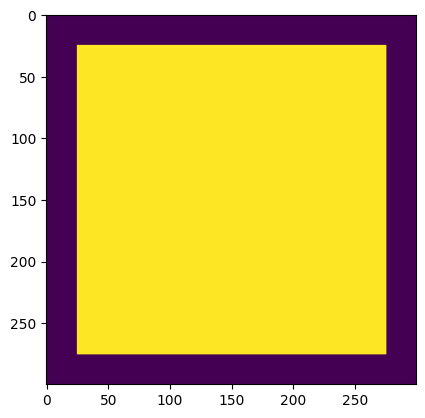

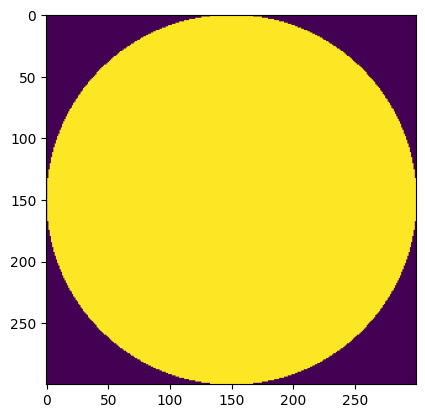

In [ ]:
#Mostrando as formas:
plt.imshow(fundo)
plt.show()
plt.imshow(fundo2)
plt.show()

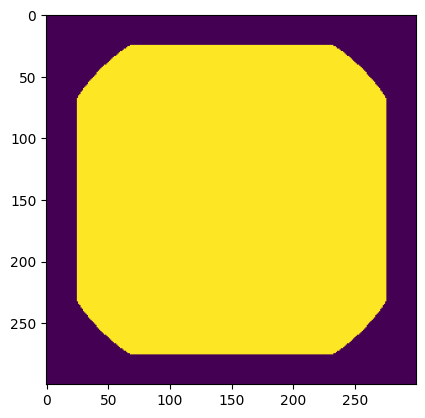

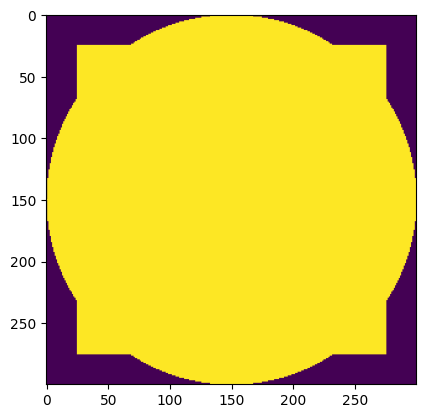

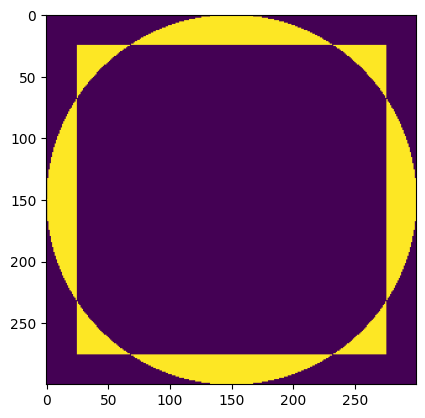

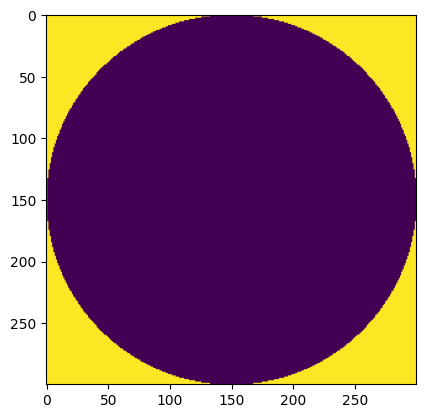

In [ ]:
#Bitwise_AND:
plt.imshow(bitwise_AND)
plt.show()

#Bitwise_OR:
plt.imshow(bitwise_OR)
plt.show()

#Bitwise_XOR:
plt.imshow(bitwise_XOR)
plt.show()

#Bitwise_NOT:
plt.imshow(bitwise_NOT)
plt.show()

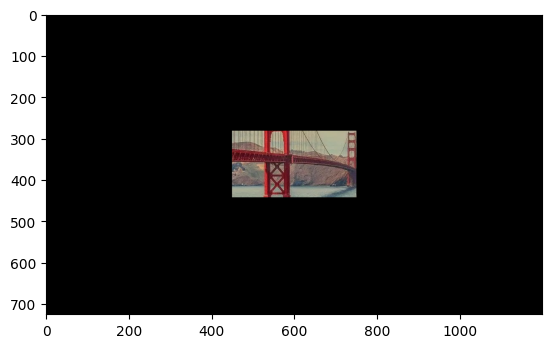

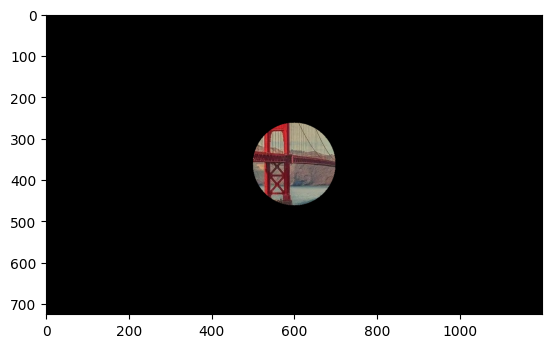

In [ ]:
# Criando mascaras para imagens com Masking, util para segmentaçoes de instancias:
# O mascaramento funciona da seguinte forma: Criamos primeiro uma máscara que vai definir a região da imagem que queremos coletar
# Depois, iremos aplicar a função bitwise_and da imagem original com ela mesma, onde a máscara será usada junto. No caso
# máscara terá uma comparação de localização pixel a pixel com as localizaçoes da imagem original, pportanto apenas uma região
# desenhada na mascara será coletada. Isso ficará mais fácil de se compreender ao olhar para o código de aplicação de mascara.
import numpy as np
mask = np.zeros(imagem_col.shape[:2], dtype = "uint8")
(cX, cY) = (imagem_col.shape[1]//2, imagem_col.shape[0]//2)
cv2.rectangle(mask, (cX - 150, cY - 80), (cX + 150, cY + 80), 255, -1)

# Aplicando a mascará retangular:
primeira_mascara = cv2.bitwise_and(imagem_col, imagem_col, mask = mask)

# Mascara circular com o raio de 100 pixels:
mask2 = np.zeros(imagem_col.shape[:2], dtype = "uint8")
cv2.circle(mask2, (cX, cY), 100, 255, -1)
segunda_mascara = cv2.bitwise_and(imagem_col, imagem_col, mask = mask2)

# Mostrando as imagens:
plt.imshow(primeira_mascara)
plt.show()
plt.imshow(segunda_mascara)
plt.show()

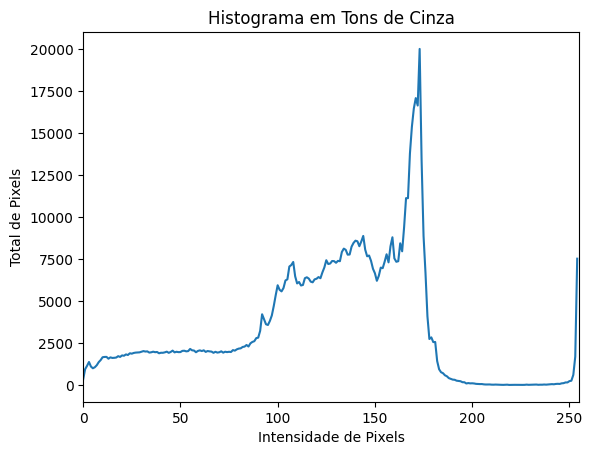

In [ ]:
# Criando histogramas de imagens:
# Convertendo de BGR para Grayscale:
imagem_cinza = cv2.cvtColor(imagem_col, cv2.COLOR_BGR2GRAY)

# Criando o histograma:
histograma = cv2.calcHist(images=[imagem_cinza], channels=[0], mask=None,
                          histSize=[255], ranges=[0,255])

# Mostrando o histograma:
plt.figure()
plt.title("Histograma em Tons de Cinza")
plt.xlabel("Intensidade de Pixels")
plt.ylabel("Total de Pixels")
plt.plot(histograma)
plt.xlim([0,255])
plt.show()

<ipython-input-78-38b207ccc8e1>:2: MatplotlibDeprecationWarning: Passing the range parameter of hist() positionally is deprecated since Matplotlib 3.9; the parameter will become keyword-only in 3.11.
  plt.hist(imagem_cinza.ravel(),255,[0,255])


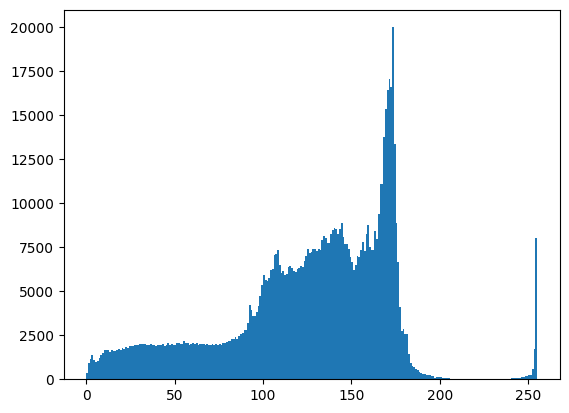

In [ ]:
# Criando o histograma com o, ravel(), vai ficar preenchido
plt.hist(imagem_cinza.ravel(),255,[0,255])
plt.show()

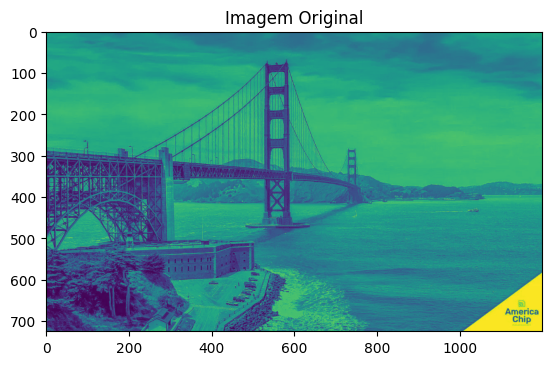

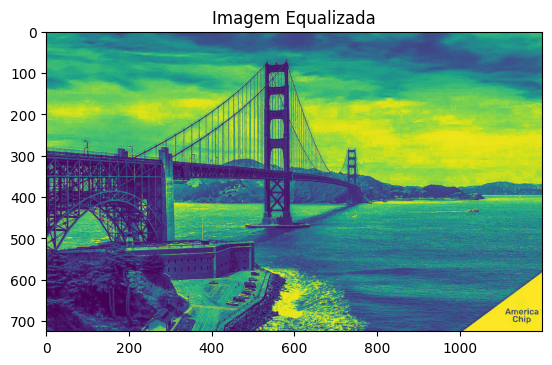

In [ ]:
# Equalização de histograma:
# Basicamente ele de constraste e realsa os pixels, para que eles entregem mais detalhes,
# Evitando tons muito claros e opacos.
# Convertendo imagem para cinza:
imagem_cinza = cv2.cvtColor(imagem_col, cv2.COLOR_BGR2GRAY)

# Equalizando o histograma:
imagem_eq = cv2.equalizeHist(imagem_cinza)

# Mostrando
plt.figure()
plt.title("Imagem Original")
plt.imshow(imagem_cinza)
plt.show()
plt.figure()
plt.title("Imagem Equalizada")
plt.imshow(imagem_eq)
plt.show()

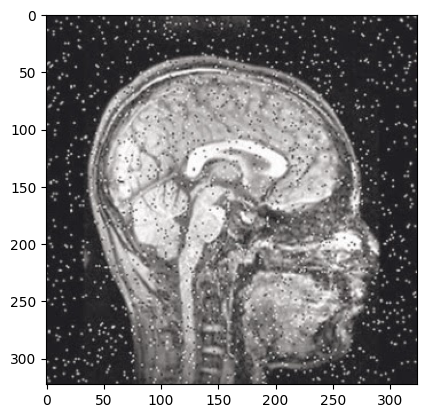

In [ ]:
# O ruido sal e pimenta, é um tipo de ruido que deixa a imagem com pontinhos pretos e brancos, dificultando assim algoritmos a analizarem
sal_pimenta = cv2.imread("/cranio.jpg")
plt.imshow(sal_pimenta)
plt.show()

In [ ]:
# Filtrando uma imagem:
# Semelhante as CNN, ele cria um filtro que vai ser passado por toda a imagem, e o pixel central desse filtro vai receber o valor mediano de todos os pixels do mesmo
# A função cv2.medianBlur é uada para remover o ruido "sal e pimenta"
# Precisa definir o tamanho do kernel "filtro" como um numero impar senão vai dar erro
# Vou usar tamém o cv2.GaussianBlur e o cv2.blur
# o cv2.blur usa o metodo Averaging filter que subistiui pela media
# o cv2.GaussianBlur substitui o pixel central por uma media ponderada dos pixels vizinhos, dando mais peso as pixels mais proximos
# Ele usa e função guaussiana para determinar os pesos dos pixels centrais, quanto mais distante menor o peso.
# Definise o valo do devio padrão, quanro maior mais borrada fica a imagem.

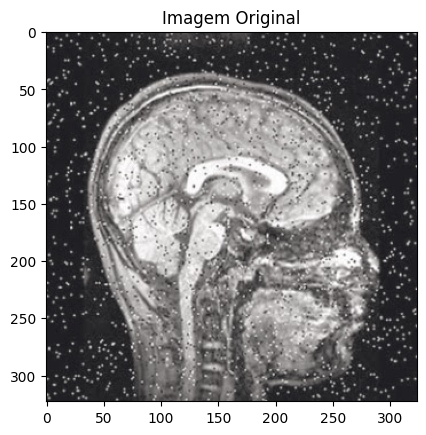

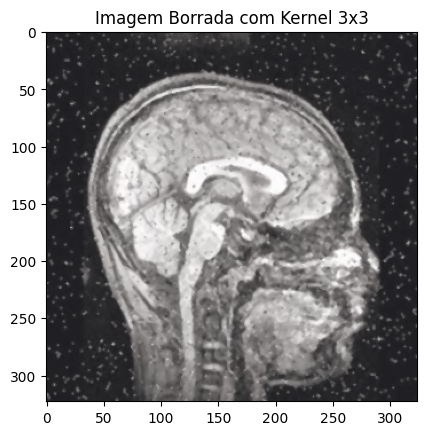

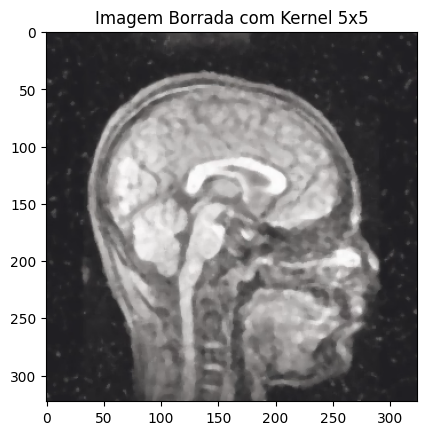

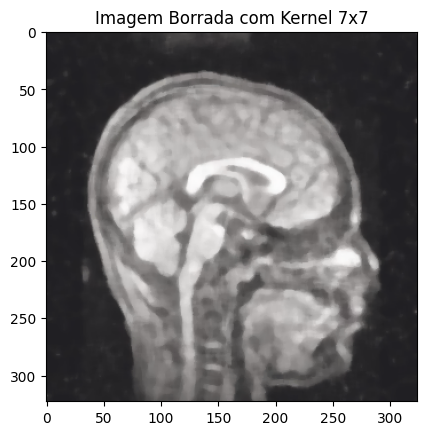

In [ ]:
# cv2.medianBlur:
from google.colab.patches import cv2_imshow
borrado_3 = cv2.medianBlur(sal_pimenta, 3) # Kernel 3x3
borrado_5 = cv2.medianBlur(sal_pimenta, 5) # Kernel 5x5
borrado_7 = cv2.medianBlur(sal_pimenta, 7) # Kernel 7x7
plt.figure()
plt.title("Imagem Original")
plt.imshow(sal_pimenta)
plt.show()
plt.figure()
plt.title("Imagem Borrada com Kernel 3x3")
plt.imshow(borrado_3)
plt.figure()
plt.title("Imagem Borrada com Kernel 5x5")
plt.imshow(borrado_5)
plt.figure()
plt.title("Imagem Borrada com Kernel 7x7")
plt.imshow(borrado_7)

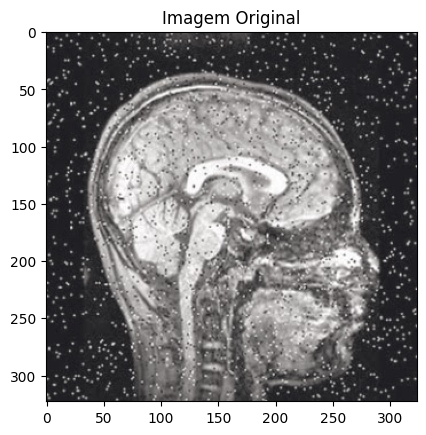

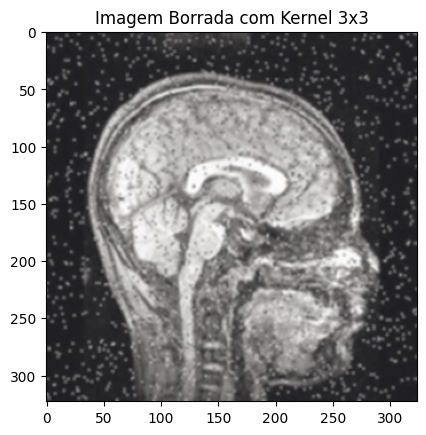

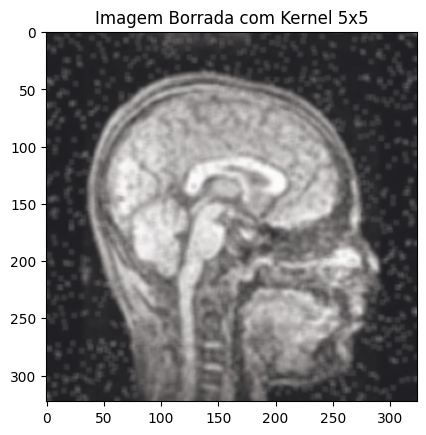

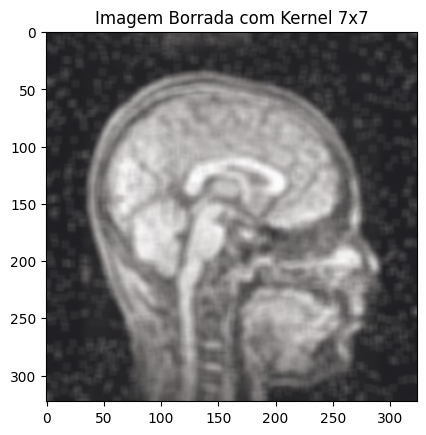

In [ ]:
# cv2.Blur:
averaging_3 = cv2.blur(sal_pimenta, (3,3)) # Kernel 3x3
averaging_5 = cv2.blur(sal_pimenta, (5,5)) # Kernel 5x5
averaging_7 = cv2.blur(sal_pimenta, (7,7)) # Kernel 7x7
plt.figure()
plt.title("Imagem Original")
plt.imshow(sal_pimenta)
plt.show()
plt.figure()
plt.title("Imagem Borrada com Kernel 3x3")
plt.imshow(averaging_3)
plt.figure()
plt.title("Imagem Borrada com Kernel 5x5")
plt.imshow(averaging_5)
plt.figure()
plt.title("Imagem Borrada com Kernel 7x7")
plt.imshow(averaging_7)

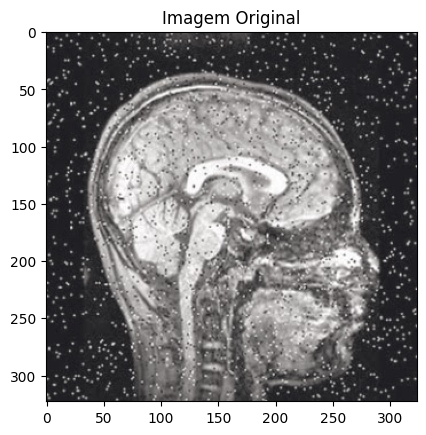

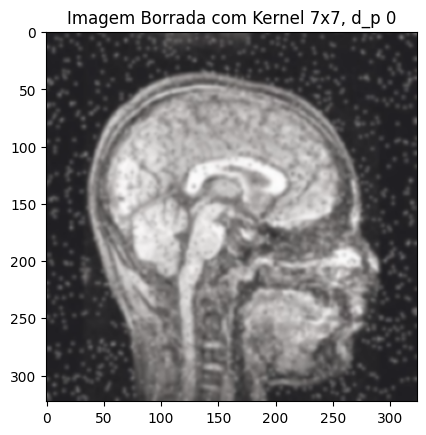

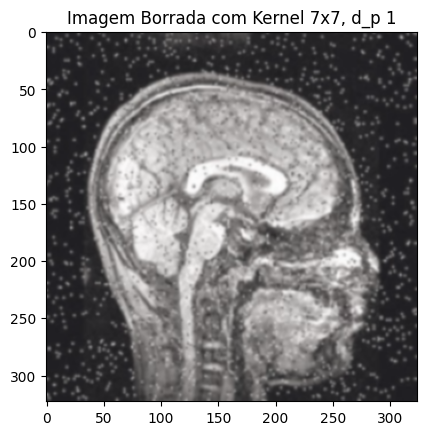

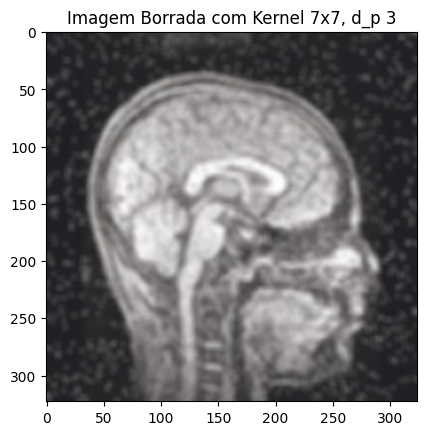

In [ ]:
# cv2.GaussianBlur:

gaussian7_0 = cv2.GaussianBlur(sal_pimenta, (7,7), 0) # Kernel 7x7, desvio padrão 0
gaussian7_1 = cv2.GaussianBlur(sal_pimenta, (7,7), 1) # KErnel 7x7, desvio padrão 1
gaussian7_3 = cv2.GaussianBlur(sal_pimenta, (7,7), 3) # Kernel 7x7, desvio padrão 3
plt.figure()
plt.title("Imagem Original")
plt.imshow(sal_pimenta)
plt.show()
plt.figure()
plt.title("Imagem Borrada com Kernel 7x7, d_p 0")
plt.imshow(gaussian7_0)
plt.figure()
plt.title("Imagem Borrada com Kernel 7x7, d_p 1")
plt.imshow(gaussian7_1)
plt.figure()
plt.title("Imagem Borrada com Kernel 7x7, d_p 3")
plt.imshow(gaussian7_3)

In [ ]:
# Aplicando operações morfológicas em imagens (erosão, dilatação, opening, closing, gradient) https://docs.opencv.org/4.x/d9/d61/tutorial_py_morphological_ops.html:
# Erosão: remove pixels perto dos limites e um objeto com o objetvo de resaltar esse objeto.
# Dilatação: é o contrario da erosão, ele adiciona pixels proximos do limite de um objeto, com o objetvo de preencher pontos faltantes.
# Opening: aplica primeiro uma erosão e deopis uma dilatação, é ultil para remover os ruidos sal e pimenta, de preferenia o sal.
# Closing: é o contrario do opening, ele aplica uma dilatação seguida de uma erosão, ultil para remover ruidos de pimenta que corronpem a imagem.
# Gradient: Pega a diferença entre a erosão e a dilatação, fica como um contoro do objeto
# Regra do codigo: (imagem, tamanho do kernel, numero de interaçoes)

In [ ]:
imagem = cv2.imread("/ponte_golden_gat.jpg")
ponte_cinza = cv2.cvtColor(imagem, cv2.COLOR_BGR2GRAY)

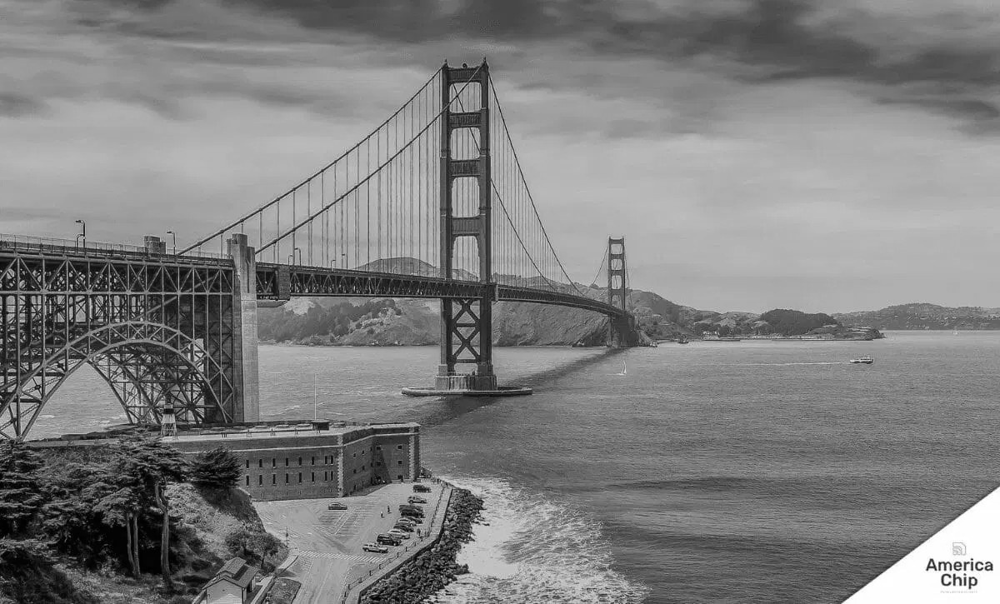

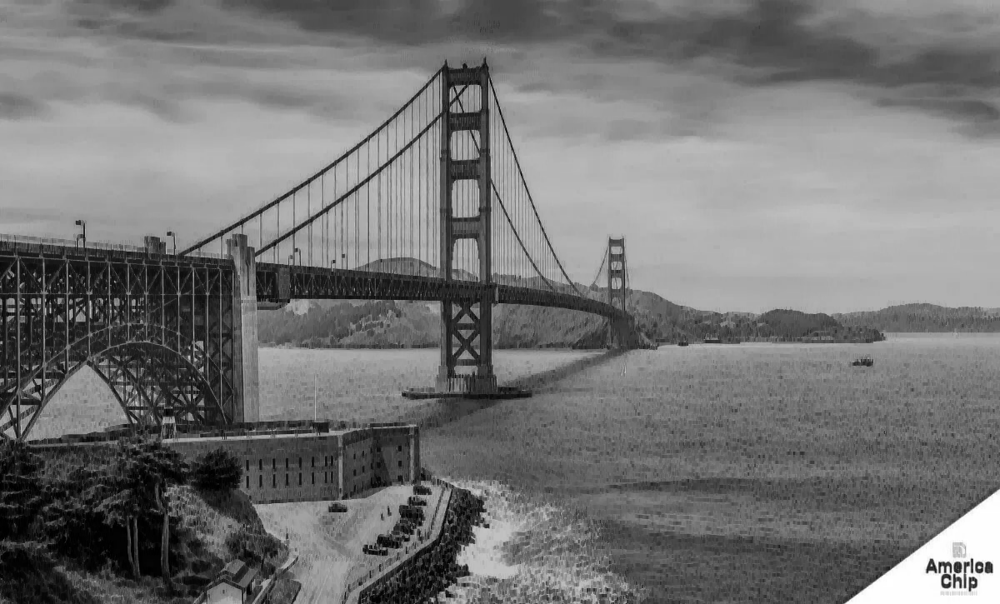

In [ ]:
# Erosão "cv2.erode":
erosao = cv2.erode(ponte_cinza, (3,3), iterations = 3)
cv2_imshow(ponte_cinza)
cv2_imshow(erosao)

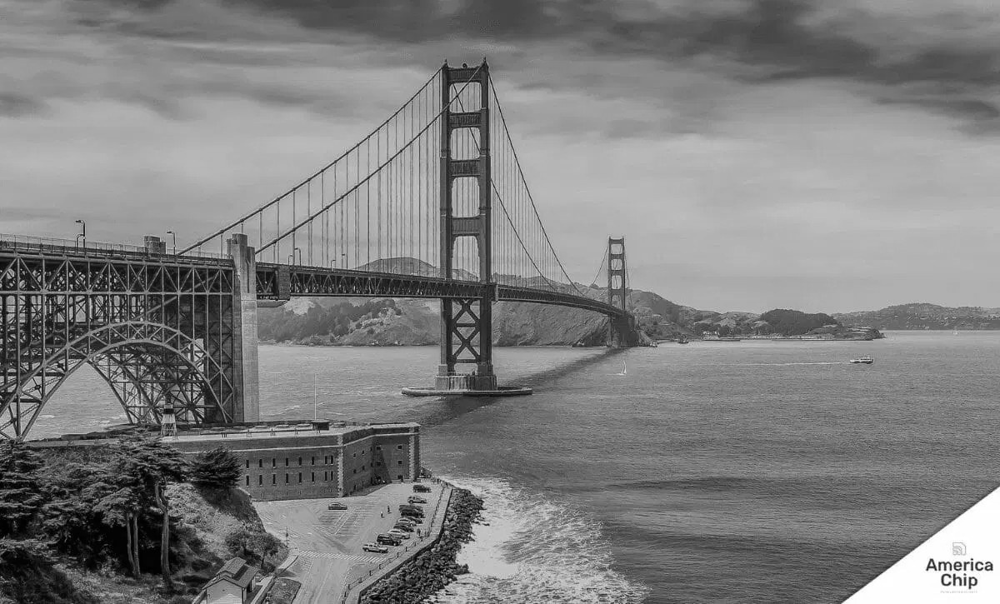

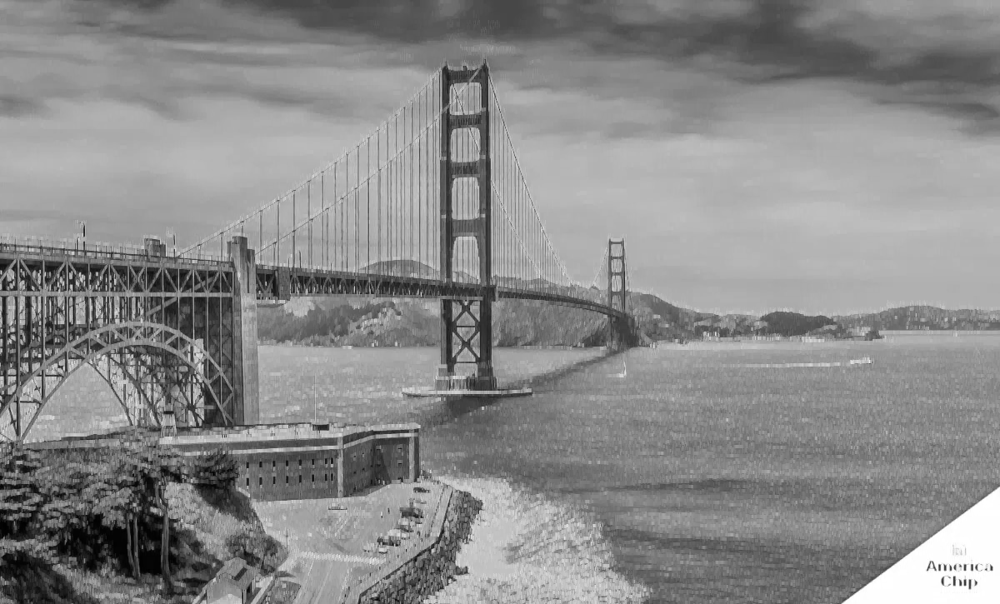

In [ ]:
# Dilatação "cv2.dilate":
dilatacao = cv2.dilate(ponte_cinza, (3,3), iterations=3)
cv2_imshow(ponte_cinza)
cv2_imshow(dilatacao)

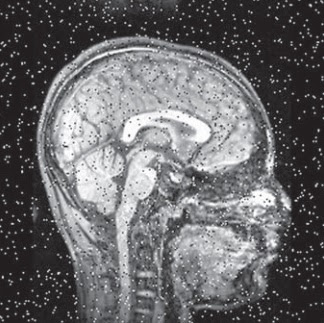

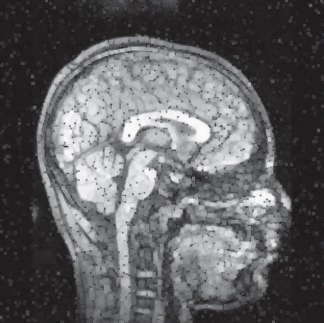

In [ ]:
# Opening "cv2.morphologyEx(cv2.MORPH_OPEN)":
opening = cv2.morphologyEx(sal_pimenta, cv2.MORPH_OPEN, None)
cv2_imshow(sal_pimenta)
cv2_imshow(opening)

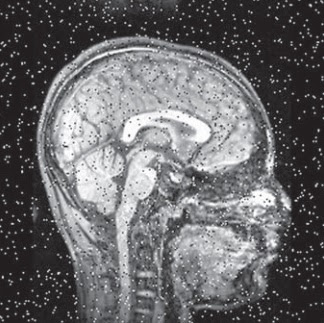

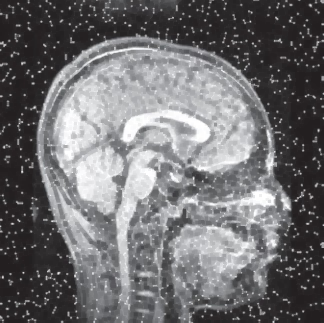

In [ ]:
# Closing "cv2.morphologyEx(cv2.MORPH_CLOSE)":
closing = cv2.morphologyEx(sal_pimenta, cv2.MORPH_CLOSE, None)
cv2_imshow(sal_pimenta)
cv2_imshow(closing)

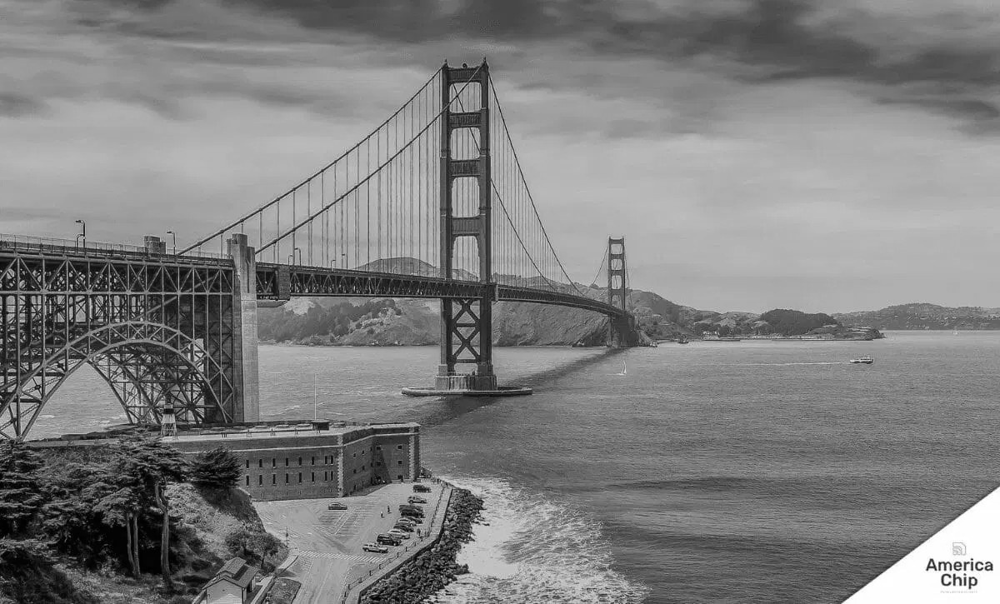

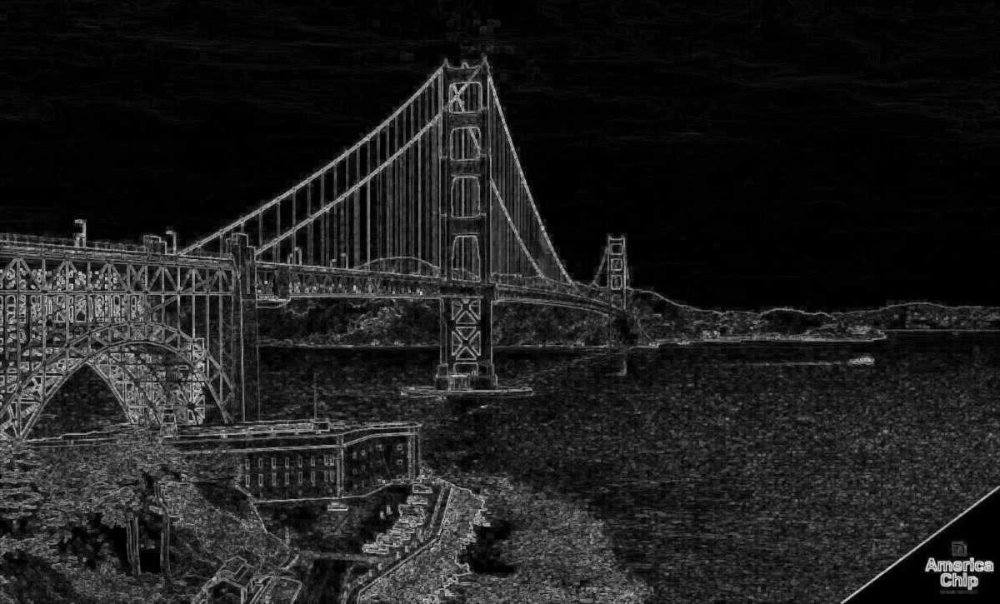

In [ ]:
# Gradient "cv2.morphologyEx(cv2.MORPH_GRADIENT)":
gradient = cv2.morphologyEx(ponte_cinza, cv2.MORPH_GRADIENT, None)
cv2_imshow(ponte_cinza)
cv2_imshow(gradient)

In [ ]:
# Gradiente da imagem:
# Em resumo, ele tenta detectar as bordas de um objeto na imagem com o minimo de ruido possivel, ele passa filtros como no cnn..
# Os seus kernels é como se fosse um pincel magico "threshold" que passa em um quadro em branco, destacando somente as bordas, reagindo a diferença de tom das areas vizinhas
# Canny Edge Detector usa dois theresholds, qualquer valor acima do thereshold alto é considerado uma borda,
# e qualquer valor baixo do thereshold é descartado "fundo",
# valores intermediarios serão considerados uma borda se estiverem conectados com threshold altos.
# Regras de codigo Canny: cv2.Canny(imagem, limiar_inferior, limiar_superior)
# Aprofundando: https://pyimagesearch.com/2021/05/12/image-gradients-with-opencv-sobel-and-scharr/

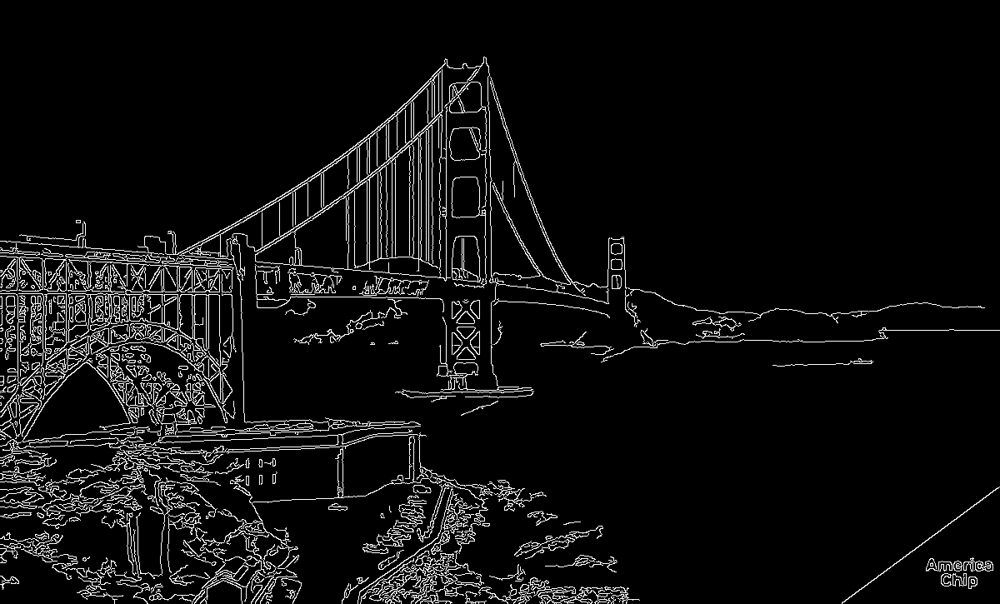

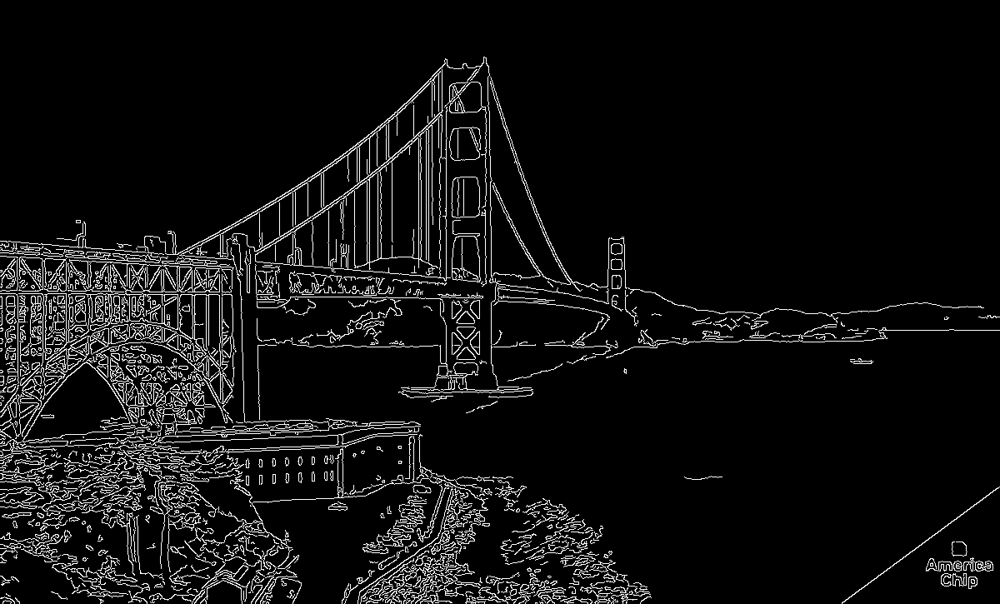

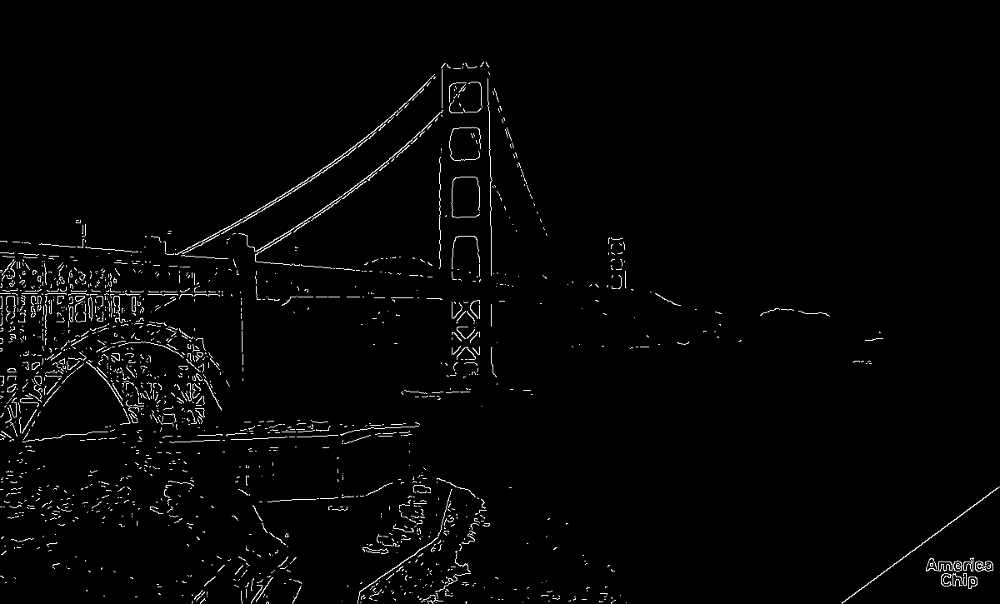

In [ ]:
# Usando o Canny Edge Detector:
imagem_com_filtro = cv2.GaussianBlur(ponte_cinza, (5,5), 0) # Aplicando filtro para não aparecer tanto ruido

# Calculando os filtros Canny om diferentes lineares:
largo = cv2.Canny(imagem_com_filtro, 50, 220)
medio = cv2.Canny(imagem_com_filtro, 70, 140)
apertado = cv2.Canny(imagem_com_filtro, 210, 220)

# Mostrando os Map Edges com diferentes linerares:
cv2_imshow(largo)
cv2_imshow(medio)
cv2_imshow(apertado)